## initial setup, run this part before any other part

In [1]:
import torch
import os
import random
import utils
import data_utils
import json

import cbm
import plots
import sys
from pathlib import Path
import matplotlib.pyplot as plt
import numpy as np

In [2]:
HOME="/home/jix049/private/"
# change this to the correct model dir, everything else should be taken care of
# load_dir = HOME+"saved_models/cub_lf_cbm"
load_dir = HOME+"saved_models/cub_lf_cbm"
# load_dir = "saved_models/cifar10_cbm_2024_10_16_16_01"
# load_dir="saved_models/cifar100_cbm_2024_10_16_17_02"
# load_dir="saved_models/cub_cbm_2024_10_20_19_48"
target_name="cub_lf_cbm"
device = "cuda"

with open(os.path.join(load_dir, "args.txt"), "r") as f:
    args = json.load(f)
dataset = args["dataset"]
_, target_preprocess = data_utils.get_target_model(args["backbone"], device)
model = cbm.load_cbm(load_dir, device)

In [3]:
val_d_probe = dataset+"_val"
cls_file = data_utils.LABEL_FILES[dataset]

val_data_t = data_utils.get_data(val_d_probe, preprocess=target_preprocess)
val_pil_data = data_utils.get_data(val_d_probe)

In [4]:
with open(cls_file, "r") as f:
    classes = f.read().split("\n")

with open(os.path.join(load_dir, "concepts.txt"), "r") as f:
    concepts = f.read().split("\n")

## Measure accuracy

In [9]:
accuracy = utils.get_accuracy_cbm(model, val_data_t, device)
print("Accuracy: {:.2f}%".format(accuracy*100))

100%|██████████| 40/40 [00:21<00:00,  1.83it/s]

Accuracy: 87.25%


You can build a Sankey diagram of weights by copying the incoming weights printed below into https://sankeymatic.com/build/

In [6]:
to_show = random.choices([i for i in range(len(classes))], k=1)

for i in to_show:
    print("Output class:{} - {}".format(i, classes[i]))
    print("Incoming weights:")
    for j in range(len(concepts)):
        if torch.abs(model.final.weight[i,j])>0.05:
            print("{} [{:.4f}] {}".format(concepts[j], model.final.weight[i,j], classes[i]))

Output class:174 - Pine Warbler
Incoming weights:
a white underparts [0.0984] Pine Warbler
a yellow upper tail [0.3163] Pine Warbler
a green upper tail [0.7523] Pine Warbler
an orange upper tail [0.3279] Pine Warbler
a white upper tail [0.0970] Pine Warbler
a red upper tail [0.3738] Pine Warbler
a crested head pattern [-0.1887] Pine Warbler
a red breast [0.1559] Pine Warbler
a brown throat [-0.0576] Pine Warbler
a grey throat [-0.3205] Pine Warbler
a blue eye [0.2084] Pine Warbler
an iridescent under tail [-0.3451] Pine Warbler
a grey nape [-0.1225] Pine Warbler
a long-wings shape [-0.1445] Pine Warbler
a sandpiper-like shape [0.0760] Pine Warbler
a swallow-like shape [-0.8170] Pine Warbler
a spotted tail pattern [-0.1513] Pine Warbler
a grey primary color [-0.1825] Pine Warbler
an olive primary color [0.3482] Pine Warbler
a green primary color [0.1676] Pine Warbler
an orange primary color [0.2326] Pine Warbler
an iridescent leg [0.1759] Pine Warbler
a yellow leg [0.4280] Pine Warbler


In [7]:
to_show = random.choices([i for i in range(len(concepts))], k=1)
to_show = [99]

for i in to_show:
    print("concept:{} - {}".format(i, concepts[i]))
    print("Outgoing weights:")
    for j in range(len(classes)):
        if torch.abs(model.final.weight[j,i])>0.05:
            print("{} [{:.4f}] {}".format(concepts[i], model.final.weight[j,i], classes[j]))

concept:99 - a grey nape
Outgoing weights:
a grey nape [0.1496] Least Auklet
a grey nape [0.1237] Parakeet Auklet
a grey nape [-0.1510] Indigo Bunting
a grey nape [-0.5454] American Crow
a grey nape [0.0603] Mangrove Cuckoo
a grey nape [0.0571] Purple Finch
a grey nape [0.4021] Olive sided Flycatcher
a grey nape [-0.1055] Frigatebird
a grey nape [0.2877] Eared Grebe
a grey nape [0.3591] Horned Grebe
a grey nape [0.0926] Pied billed Grebe
a grey nape [-0.2483] Evening Grosbeak
a grey nape [-0.1700] Rufous Hummingbird
a grey nape [-0.0701] Blue Jay
a grey nape [0.0528] Florida Jay
a grey nape [0.2835] Gray Kingbird
a grey nape [-0.2438] White breasted Kingfisher
a grey nape [-0.1058] Baltimore Oriole
a grey nape [0.3559] Western Wood Pewee
a grey nape [0.1077] Brewer Sparrow
a grey nape [0.0769] Henslow Sparrow
a grey nape [0.4368] Nelson Sharp tailed Sparrow
a grey nape [-0.1529] Summer Tanager
a grey nape [0.2946] Black throated Blue Warbler
a grey nape [0.2099] Nashville Warbler
a gre

## Show final layer weights for some classes

In [8]:
# Count negative and positive weights for each feature
negative_counts = torch.sum(model.final.weight < -0.05, dim=0)
positive_counts = torch.sum(model.final.weight > 0.05, dim=0)

# Calculate the ratio of negative to positive weights
# Adding a small epsilon to avoid division by zero
epsilon = 1e-10
negative_to_positive_ratio = negative_counts / (positive_counts + epsilon)

# Find the feature (index) with the highest negative to positive ratio
feature_with_highest_ratio = torch.argmax(negative_to_positive_ratio).item()

# Get the actual ratio for this feature
max_ratio = negative_to_positive_ratio[feature_with_highest_ratio].item()

# Get counts for the feature with the highest ratio
feature_negative_count = negative_counts[feature_with_highest_ratio].item()
feature_positive_count = positive_counts[feature_with_highest_ratio].item()
total_weights = model.final.weight.shape[0]

print(f"Feature {feature_with_highest_ratio} has the highest ratio of negative to positive weights.")
print(f"Negative to positive ratio: {max_ratio:.2f}")
print(f"It has {feature_negative_count} negative weights and {feature_positive_count} positive weights")
print(f"out of {total_weights} total incoming weights.")

# Calculate percentages
negative_percentage = (feature_negative_count / total_weights) * 100
positive_percentage = (feature_positive_count / total_weights) * 100

print(f"Negative weights represent {negative_percentage:.2f}% of its incoming weights.")
print(f"Positive weights represent {positive_percentage:.2f}% of its incoming weights.")

Feature 47 has the highest ratio of negative to positive weights.
Negative to positive ratio: 1.75
It has 14 negative weights and 8 positive weights
out of 200 total incoming weights.
Negative weights represent 7.00% of its incoming weights.
Positive weights represent 4.00% of its incoming weights.


In [15]:
total_sum = torch.sum(model.final.weight).item()

print(f"The sum of all weights in model.final.weight is: {total_sum}")

# Assuming model.final.weight is a PyTorch tensor
positive_count = torch.sum(model.final.weight > 0).item()
negative_count = torch.sum(model.final.weight < 0).item()
zero_count = torch.sum(model.final.weight == 0).item()

total_weights = model.final.weight.numel()

print(f"Positive weights: {positive_count}")
print(f"Negative weights: {negative_count}")
print(f"Zero weights: {zero_count}")
print(f"Total weights: {total_weights}")

The sum of all weights in model.final.weight is: 414.9124755859375
Positive weights: 3695
Negative weights: 2426
Zero weights: 28479
Total weights: 34600


In [9]:
# to_show = random.choices([i for i in range(len(classes))], k=2)
to_show = [44]

top_weights, top_weight_ids = torch.topk(model.final.weight, k=10, dim=1)
bottom_weights, bottom_weight_ids = torch.topk(model.final.weight, k=10, dim=1, largest=False)

for i in to_show:
    print("Class {} - {}".format(i, classes[i]))
    out = "Highest weights: "
    for j in range(top_weights.shape[1]):
        idx = int(top_weight_ids[i, j].cpu())
        out += "{}:{:.3f}, ".format(concepts[idx], top_weights[i, j])
    print(out)
    out = "Lowest weights: "
    for j in range(bottom_weights.shape[1]):
        idx = int(bottom_weight_ids[i, j].cpu())
        out += "{}:{:.3f}, ".format(concepts[idx], bottom_weights[i, j])
    print(out + "\n")

Class 44 - Northern Fulmar
Highest weights: a purple belly:0.575, a grey wing:0.323, a duck-like shape:0.297, a white belly:0.263, a blue breast:0.229, an owl-like shape:0.224, a blue upper tail:0.184, a brown under tail:0.179, a brown underparts:0.174, a black back:0.172, 
Lowest weights: a pink primary color:-1.039, a black primary color:-0.510, a purple throat:-0.485, a blue throat:-0.369, a brown primary color:-0.361, a brown throat:-0.141, a pink bill:-0.102, a red primary color:-0.054, a rufous primary color:-0.002, a hooked seabird bill:0.000, 



In [13]:
# Some features may not have any non-zero outgoing weights, 
# i.e. these are not used by the model and should be deleted for better performance
weight_contribs = torch.sum(torch.abs(model.final.weight), dim=0)
print("Num concepts with outgoing weights:{}/{}".format(torch.sum(weight_contribs>1e-5), len(weight_contribs)))

Num concepts with outgoing weights:173/173


## Explain model reasoning for random inputs

In [10]:
from IPython.display import display, HTML

display(HTML('''
    <script>
        IPython.OutputArea.prototype._should_scroll = function(lines) {
            return false;
        }
    </script>
    <style>
        .output_wrapper, .output {
            height:auto !important;
            max-height:none;
        }
        .output_scroll {
            box-shadow:none !important;
            webkit-box-shadow:none !important;
        }
    </style>
'''))

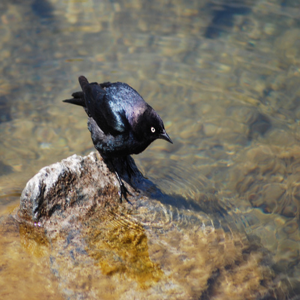

Image:187 Gt:Brewer Blackbird, 1st Pred:Brewer Blackbird, 6.896, 2nd Pred:Common Raven, 5.331


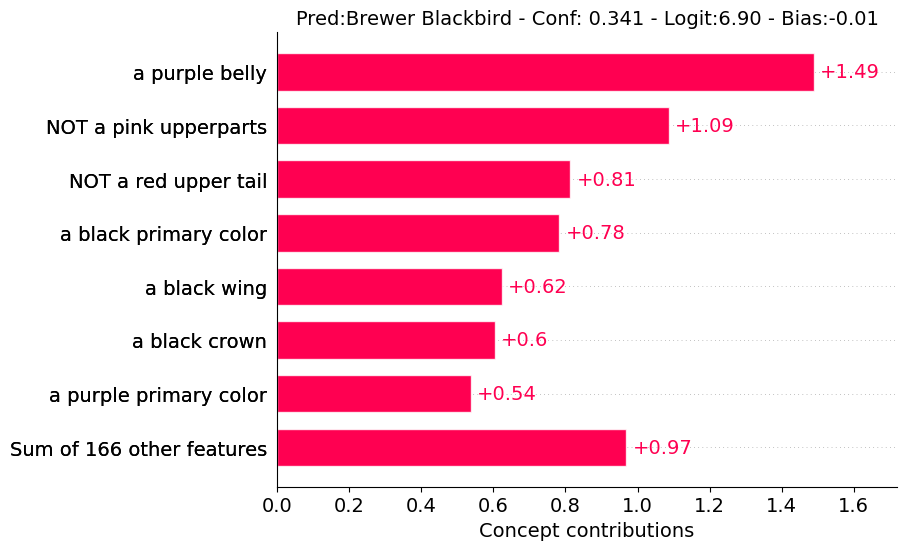

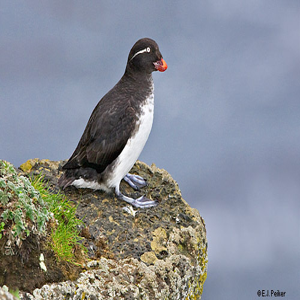

Image:152 Gt:Parakeet Auklet, 1st Pred:Parakeet Auklet, 9.909, 2nd Pred:Least Auklet, 6.166


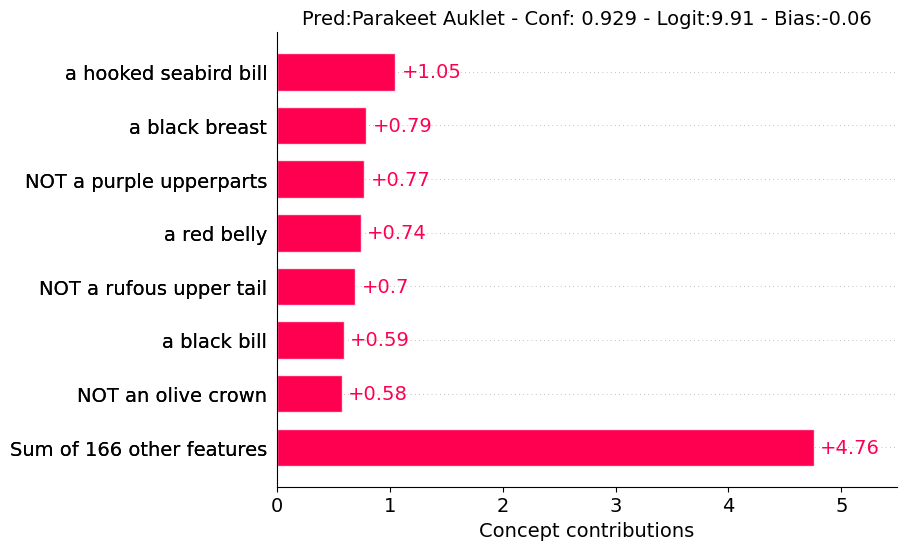

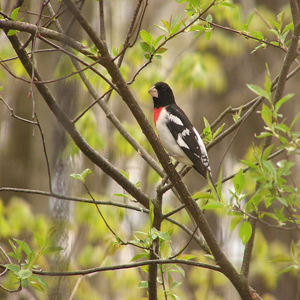

Image:1580 Gt:Rose breasted Grosbeak, 1st Pred:Rose breasted Grosbeak, 7.685, 2nd Pred:Red winged Blackbird, 5.721


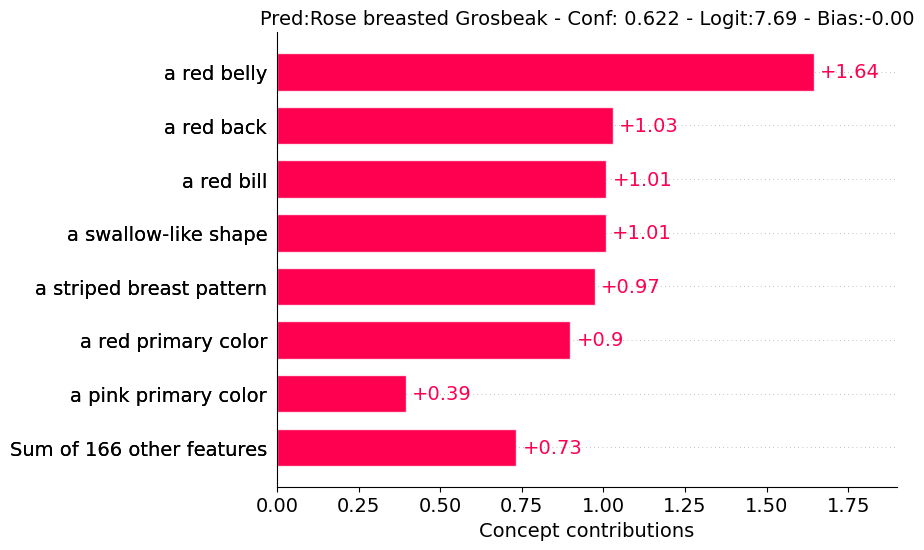

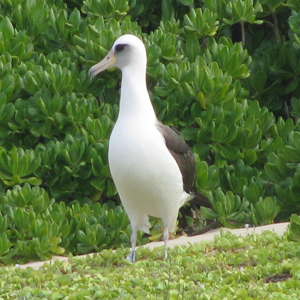

Image:58 Gt:Laysan Albatross, 1st Pred:Laysan Albatross, 7.426, 2nd Pred:California Gull, 4.789


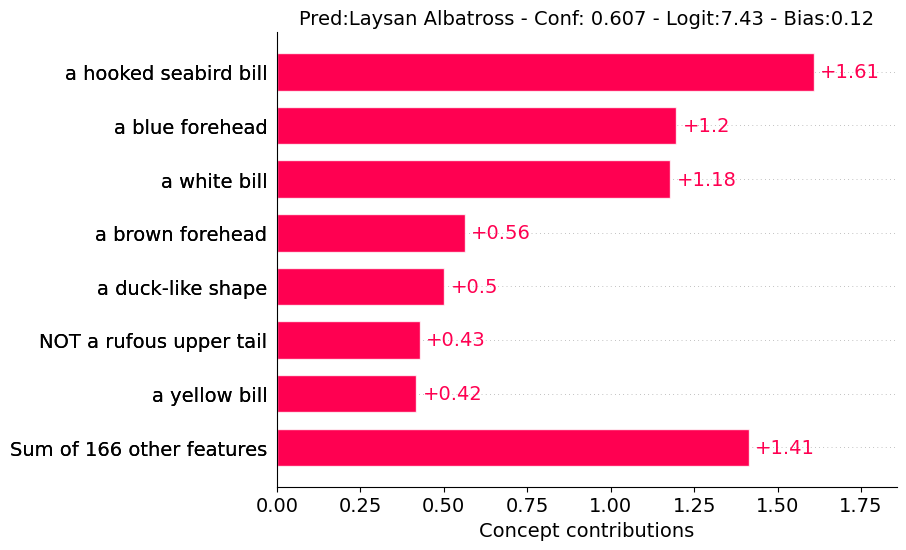

In [12]:
to_display = random.sample([i for i in range(len(val_pil_data))], k=4)
# to_display=range(0,5,1)

with torch.no_grad():
    for i in to_display:
        image, label = val_pil_data[i]
        x, _ = val_data_t[i]
        x = x.unsqueeze(0).to(device)
        display(image.resize([300,300]))
        
        outputs, concept_act = model(x)
        
        top_logit_vals, top_classes = torch.topk(outputs[0], dim=0, k=2)
        conf = torch.nn.functional.softmax(outputs[0], dim=0)
        print("Image:{} Gt:{}, 1st Pred:{}, {:.3f}, 2nd Pred:{}, {:.3f}".format(i, classes[int(label)], classes[top_classes[0]], top_logit_vals[0],
                                                                      classes[top_classes[1]], top_logit_vals[1]))
        
        for k in range(1):
            contributions = concept_act[0]*model.final.weight[top_classes[k], :]
            feature_names = [("NOT " if concept_act[0][i] < 0 else "") + concepts[i] for i in range(len(concepts))]
            values = contributions.cpu().numpy()
            max_display = min(int(sum(abs(values)>0.005))+1, 8)
            title = "Pred:{} - Conf: {:.3f} - Logit:{:.2f} - Bias:{:.2f}".format(classes[top_classes[k]],
                             conf[top_classes[k]], top_logit_vals[k], model.final.bias[top_classes[k]])
            plots.bar(values, feature_names, max_display=max_display, title=title, fontsize=14)
            

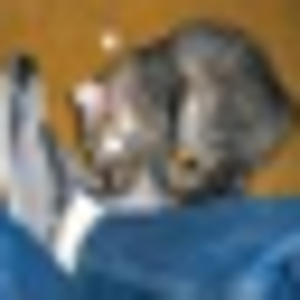

Image:0 Gt:cat, 1st Pred:frog, 4.532, 2nd Pred:cat, 3.811


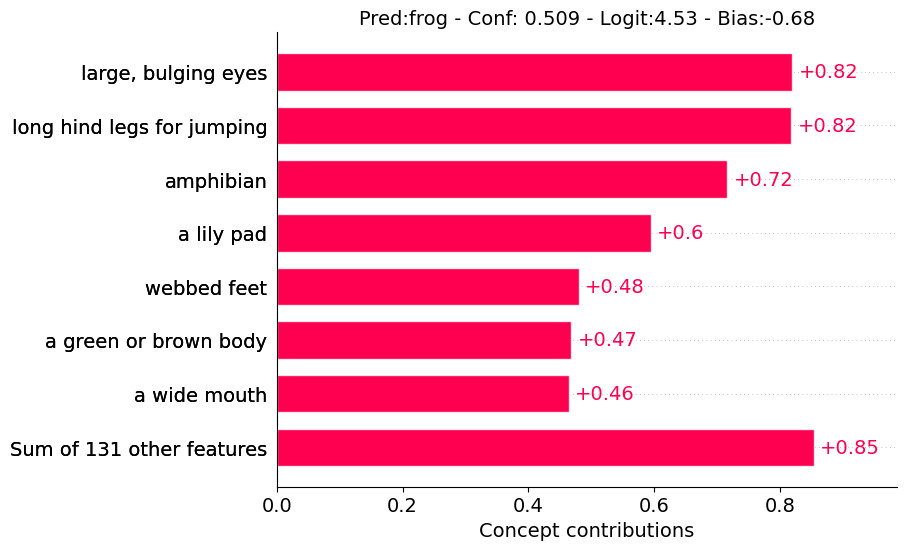

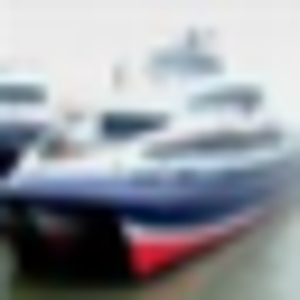

Image:1 Gt:ship, 1st Pred:ship, 8.451, 2nd Pred:airplane, 5.038


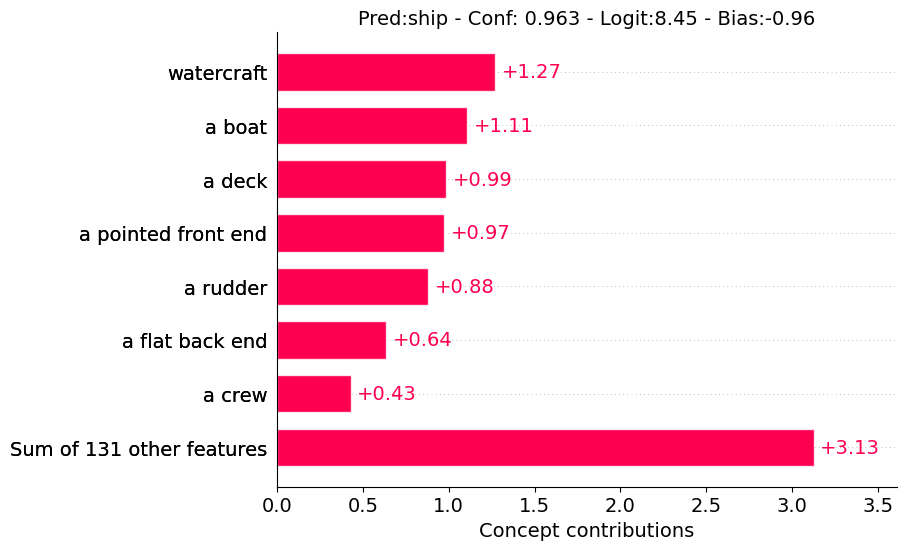

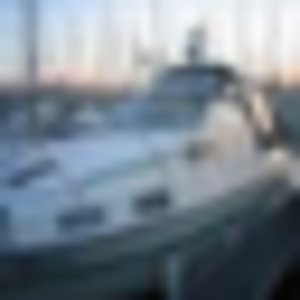

Image:2 Gt:ship, 1st Pred:ship, 9.599, 2nd Pred:automobile, 4.057


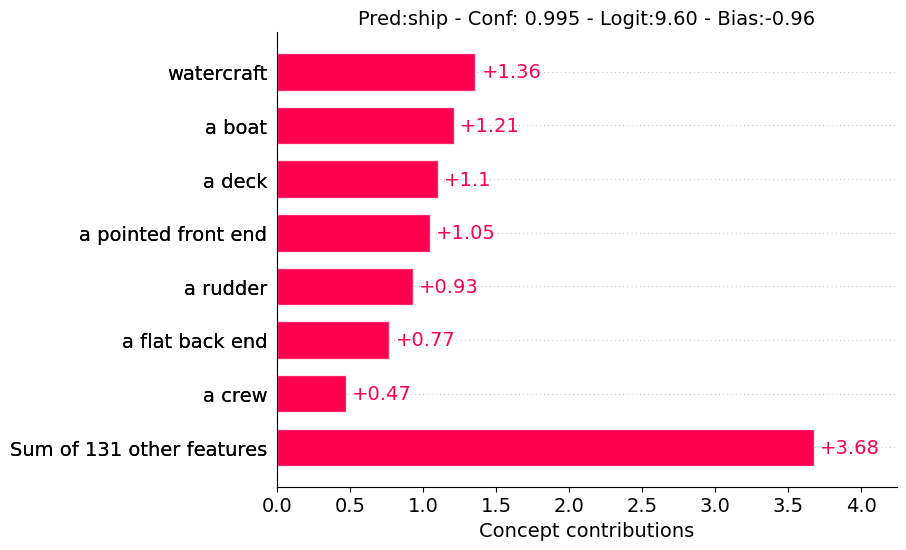

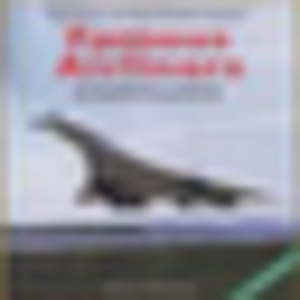

Image:3 Gt:airplane, 1st Pred:airplane, 5.877, 2nd Pred:ship, 4.512


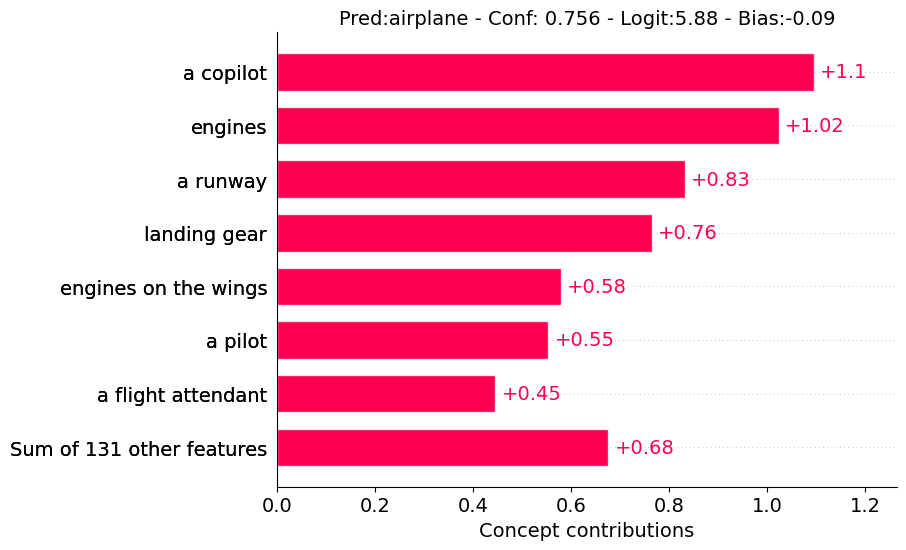

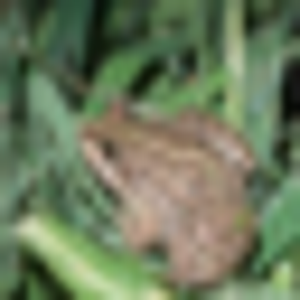

Image:4 Gt:frog, 1st Pred:frog, 8.890, 2nd Pred:bird, 4.260


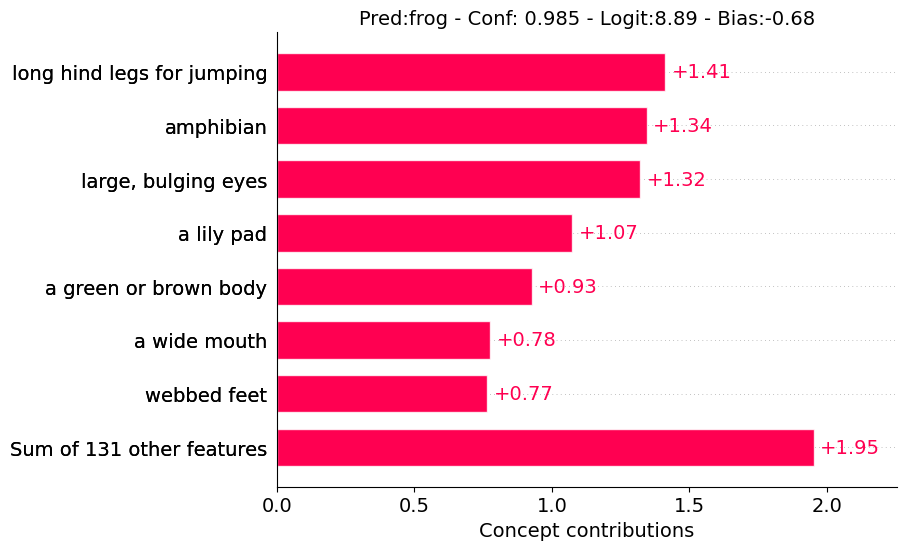

In [25]:
# to_display = random.sample([i for i in range(len(val_pil_data))], k=4)
to_display=range(0,5,1)

with torch.no_grad():
    for i in to_display:
        image, label = val_pil_data[i]
        x, _ = val_data_t[i]
        x = x.unsqueeze(0).to(device)
        display(image.resize([300,300]))
        
        outputs, concept_act = model(x)
        
        top_logit_vals, top_classes = torch.topk(outputs[0], dim=0, k=2)
        conf = torch.nn.functional.softmax(outputs[0], dim=0)
        print("Image:{} Gt:{}, 1st Pred:{}, {:.3f}, 2nd Pred:{}, {:.3f}".format(i, classes[int(label)], classes[top_classes[0]], top_logit_vals[0],
                                                                      classes[top_classes[1]], top_logit_vals[1]))
        
        for k in range(1):
            contributions = concept_act[0]*model.final.weight[top_classes[k], :]
            feature_names = [("NOT " if concept_act[0][i] < 0 else "") + concepts[i] for i in range(len(concepts))]
            values = contributions.cpu().numpy()
            max_display = min(int(sum(abs(values)>0.005))+1, 8)
            title = "Pred:{} - Conf: {:.3f} - Logit:{:.2f} - Bias:{:.2f}".format(classes[top_classes[k]],
                             conf[top_classes[k]], top_logit_vals[k], model.final.bias[top_classes[k]])
            plots.bar(values, feature_names, max_display=max_display, title=title, fontsize=14)

## show highest activation for neuron

In [5]:
import linear_explanation as le
import pandas as pd
import math

In [6]:
target_name = "cub_lf_cbm" #"cifar10_lf_cbm"
dataset_name = "cub_val"
target_layer = "proj_layer"
save_dir = 'saved_activations'
save_path = '{}/{}_{}/{}/'.format(save_dir, target_name, dataset_name, target_layer)
device = "cuda"
batch_size=128
pool_mode = "avg"#"avg"#"first"
dataset=val_data_t
true_concepts=concepts

In [7]:
def plot_images(images, axs):
    """
    images: list
    """
    
    for i, top_id in enumerate(images):
        #normalize to 0-1 range
#         if activations != None:
#             curr_act = activations[top_id]
#             curr_act -= curr_act.min()
#             curr_act /= curr_act.max()
#             mask = curr_act.unsqueeze(0)
#         else:
#             mask = torch.ones((1, 1, 1))
                    
        x, label = val_pil_data[top_id]
        axs[i].imshow(x)
        axs[i].axis('off')

In [8]:
# target_neurons=range(0,10,1)
target_neurons=[18]

Neuron 18 - a black tail


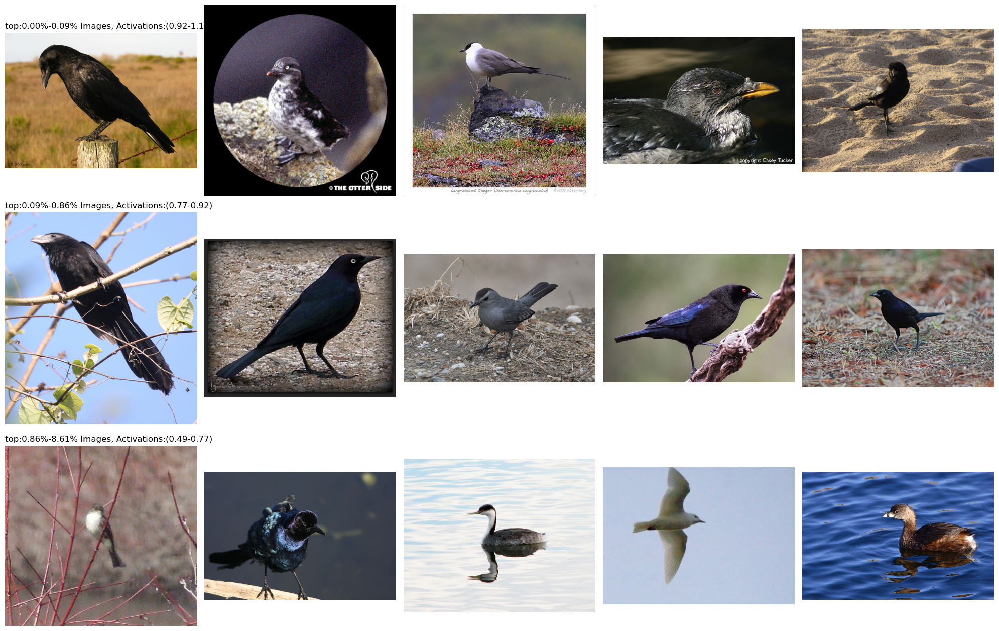

In [9]:
all_activations = le.save_summary_activations(model, dataset, device, target_layer, batch_size, save_path, pool_mode="avg")
for i in target_neurons:
    target_neuron=i
    summary_activations = all_activations[:, target_neuron]
    sorted_act_vals, sorted_act_ids = torch.sort(summary_activations, descending=True)

    explanations = {"clip_dissect":None, "le_label":None, "le_siglip":None} 

    for method in explanations:
        try:
            explanation_path = "results/{}_{}_{}.csv".format(method,target_name, target_layer)
            df = pd.read_csv(explanation_path)
            if method.startswith("le_"):
                explanations[method] = linear_to_str(df, target_neuron)
            else:
                explanations[method] = df[df["unit"]==target_neuron]["description"].iloc[0]
        except(FileNotFoundError):
            explanations[method] = "N/A"

    print("Neuron {} - {}".format(int(target_neuron),true_concepts[i]))
    for i, method in enumerate(explanations):
        if explanations[method] != "N/A":
            method_name = nice_names[method]
            explanation = explanations[method]
            wrapped_explanation = wrap_text(explanation, max_width=80 - len(method_name) - 2)  # -2 for ": "
            explanation_lines = wrapped_explanation.split('\n')
            print(f"{method_name}: {explanation_lines[0]}")
            for line in explanation_lines[1:]:
                print(line)

    nums = [0, 5, 50, 500]
    n_images = 5

    # Calculate total number of rows needed
    total_rows = sum([math.ceil(min(n_images, num - prev_num) / 5) for prev_num, num in zip(nums[:-1], nums[1:])])

    fig, ax = plt.subplots(nrows=total_rows, ncols=5, figsize=(4*5, 4.4*total_rows))

    row_index = 0
    for i, num in enumerate(nums[1:]):
        prev_num = nums[i]
        available_images = num - prev_num
        images_to_show = min(n_images, available_images)

        rows_needed = math.ceil(images_to_show / 5)

        ax[row_index, 0].set_title("top:{:.2f}%-{:.2f}% Images, Activations:({:.2f}-{:.2f})".format(
            prev_num/len(summary_activations)*100,
            num/len(sorted_act_ids)*100,
            sorted_act_vals[num], sorted_act_vals[prev_num]),
            loc="left")

        torch.manual_seed(42)  # or any other fixed number
        perm = torch.randperm(available_images)
        to_show = sorted_act_ids[prev_num:num][perm[:images_to_show]]

        for j in range(images_to_show):
            row = row_index + j // 5
            col = j % 5
            plot_images([to_show[j]], axs=[ax[row, col]])

        # Hide unused axes
        for j in range(images_to_show, rows_needed * 5):
            row = row_index + j // 5
            col = j % 5
            ax[row, col].axis('off')

        row_index += rows_needed

#     # Remove any unused subplots
#     for i in range(row_index, total_rows):
#         for j in range(5):
#             fig.delaxes(ax[i, j])

    plt.tight_layout()
    plt.show()


In [10]:
# images of highest activation
to_show=sorted_act_ids[:10]
to_show

tensor([ 179,  687,  750, 1993,  142,  593, 3079,  806,  705, 2922],
       device='cuda:0')

## Saliency map

In [11]:
import numpy as np
import matplotlib.pyplot as plt

def compute_saliency_map(model, x, neuron_idx, requires_grad=True):
    """
    Compute saliency map for a specific neuron in proj_layer for a single input image.
    
    Args:
        model (CBM_model): The CBM model
        x (torch.Tensor): Single input image tensor of shape [channels, height, width]
        neuron_idx (int): Index of the neuron in proj_layer to visualize
        requires_grad (bool): Whether to compute gradients for the input
    
    Returns:
        numpy.ndarray: Saliency map for the specified neuron
    """
    # Ensure the model is in eval mode
    model.eval()
    
    # Create a copy of the input that requires gradient
    if requires_grad:
        x = x.clone().detach().requires_grad_(True)
    
    # Add batch dimension
    x_batch = x.unsqueeze(0)  # Shape becomes [1, channels, height, width]
    
    # Forward pass through backbone and proj_layer
    features = model.backbone(x_batch)
    features_flat = torch.flatten(features, 1)
    proj_output = model.proj_layer(features_flat)
    
    # Get the output for the specified neuron
    neuron_output = proj_output[0, neuron_idx]  # Take first (only) element since we have batch size 1
    
    # Compute gradients
    neuron_output.backward()
    
    # Get gradients with respect to input
    gradients = x.grad.detach()
    
    # Compute saliency map (take absolute value and max across channels)
    saliency_map = torch.max(torch.abs(gradients), dim=0)[0]
    
    # Convert to numpy and normalize to [0, 1]
    saliency_map = saliency_map.cpu().numpy()
    saliency_map = (saliency_map - saliency_map.min()) / (saliency_map.max() - saliency_map.min() + 1e-8)
    
    return saliency_map

def visualize_saliency_map(model, x, neuron_idx, normalize_input=True):
    """
    Visualize the saliency map alongside the original image.
    
    Args:
        model (CBM_model): The CBM model
        x (torch.Tensor): Single input image tensor of shape [channels, height, width]
        neuron_idx (int): Index of the neuron in proj_layer to visualize
        normalize_input (bool): Whether to normalize the input image for visualization
    """
    # Compute saliency map
    saliency_map = compute_saliency_map(model, x, neuron_idx)
    
    # Convert input image to numpy and move to CPU
    img = x.detach().cpu().numpy()
    
    # Move channels to last dimension and normalize if needed
    img = np.transpose(img, (1, 2, 0))
    if normalize_input:
        img = (img - img.min()) / (img.max() - img.min())
    
    # Create figure
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 5))
    
    # Plot original image
    ax1.imshow(img)
    ax1.set_title('Original Image')
    ax1.axis('off')
    
    # Plot saliency map
    saliency_plot = ax2.imshow(saliency_map, cmap='hot')
    ax2.set_title(f'Saliency Map (Neuron {neuron_idx}:{concepts[neuron_idx]})')
    ax2.axis('off')
    
    # Add colorbar
    plt.colorbar(saliency_plot, ax=ax2)
    
    plt.tight_layout()
    plt.show()

# Example usage:
"""
# Assuming you have your model and input image ready:
model = CBM_model(...)  # Your model initialization
model.eval()

# Prepare single input image (should be properly preprocessed and on the correct device)
x = ...  # Your input tensor of shape [channels, height, width]

# Visualize saliency map for neuron 0 in proj_layer
visualize_saliency_map(model, x, neuron_idx=0)
"""

'\n# Assuming you have your model and input image ready:\nmodel = CBM_model(...)  # Your model initialization\nmodel.eval()\n\n# Prepare single input image (should be properly preprocessed and on the correct device)\nx = ...  # Your input tensor of shape [channels, height, width]\n\n# Visualize saliency map for neuron 0 in proj_layer\nvisualize_saliency_map(model, x, neuron_idx=0)\n'

'a black tail'

'image: 179'

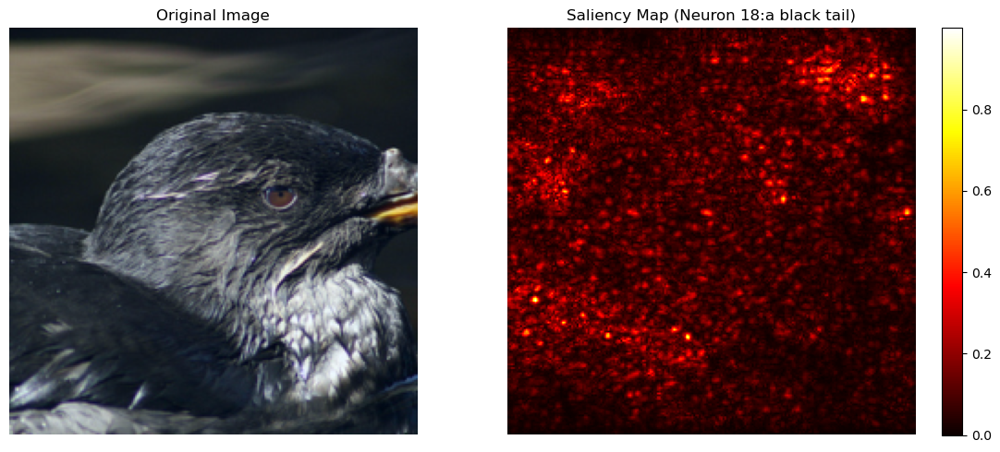

'image: 687'

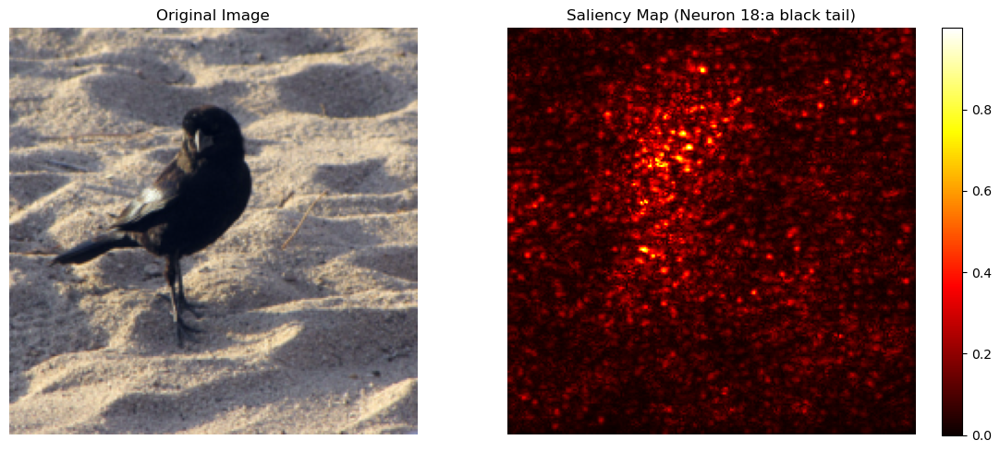

'image: 750'

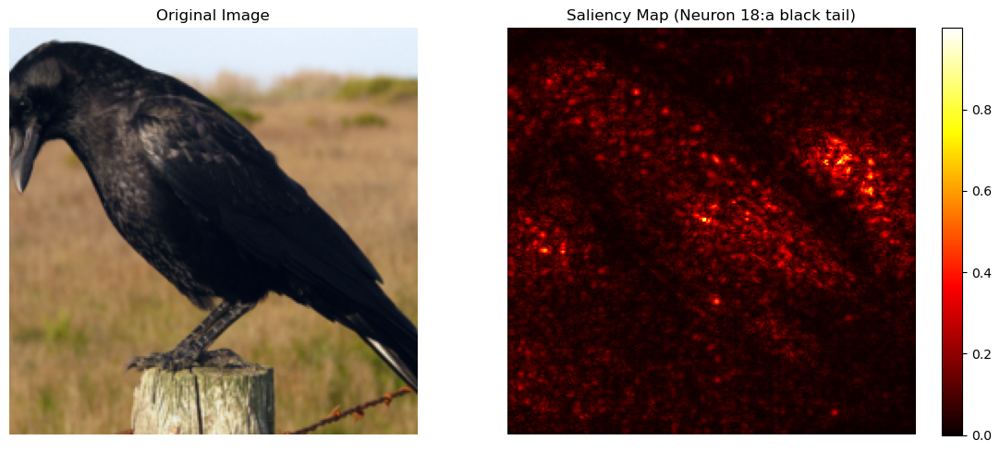

'image: 1993'

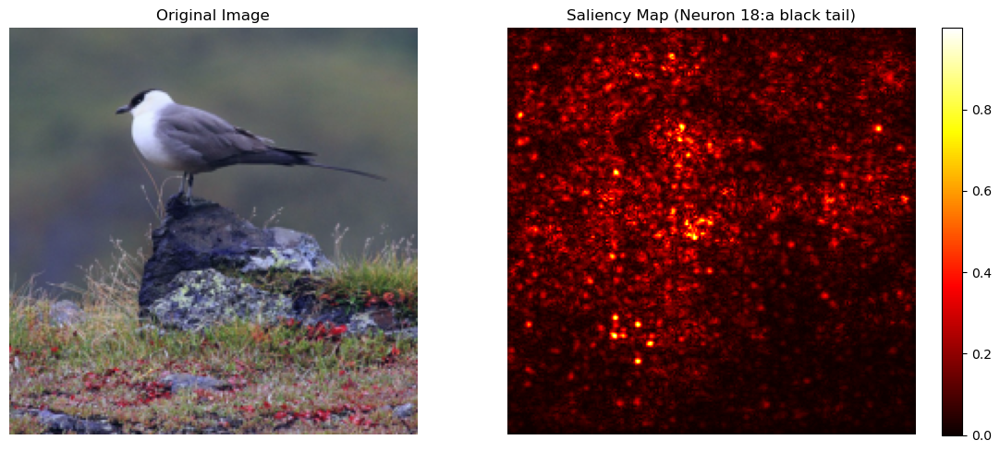

'image: 142'

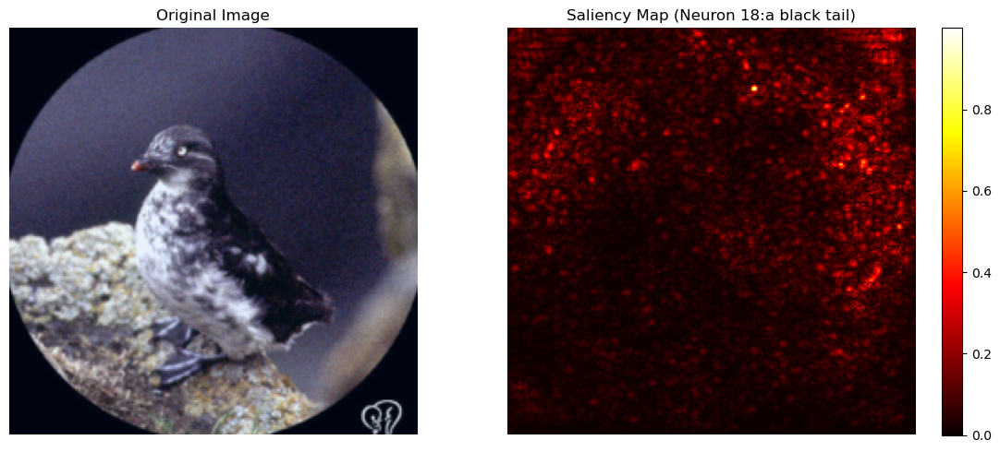

'image: 593'

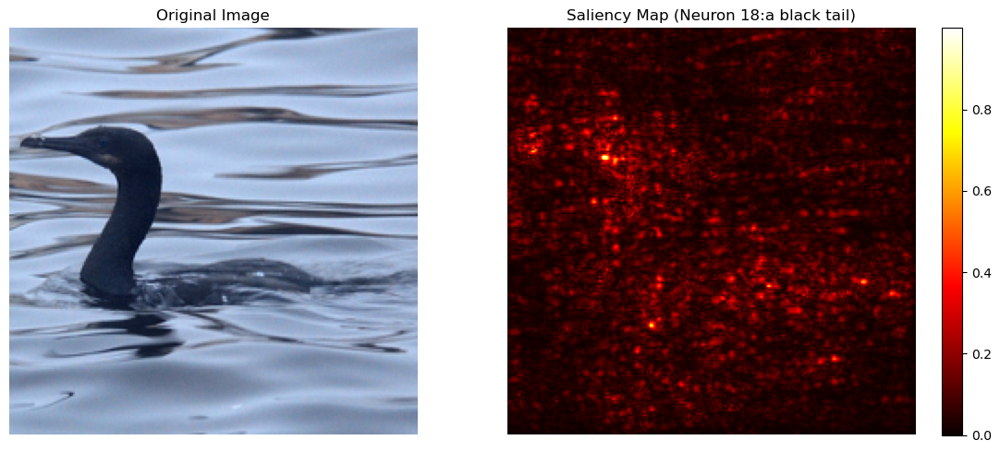

'image: 3079'

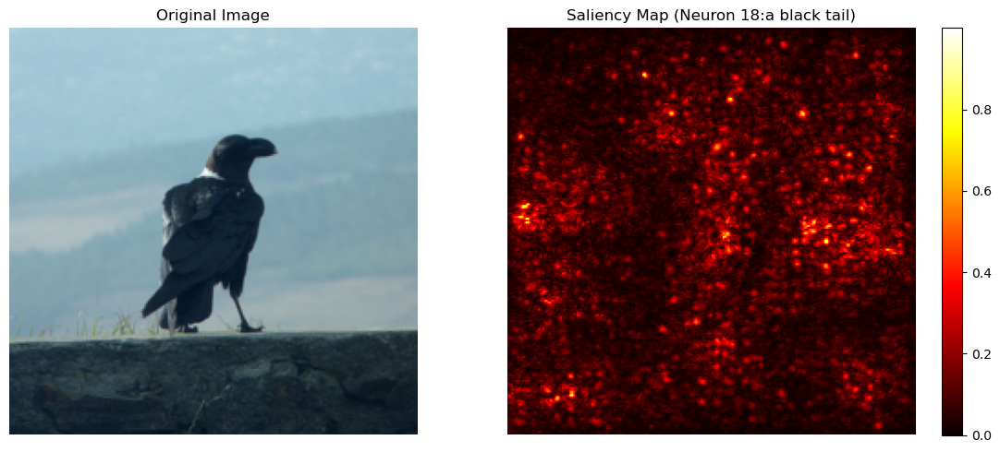

'image: 806'

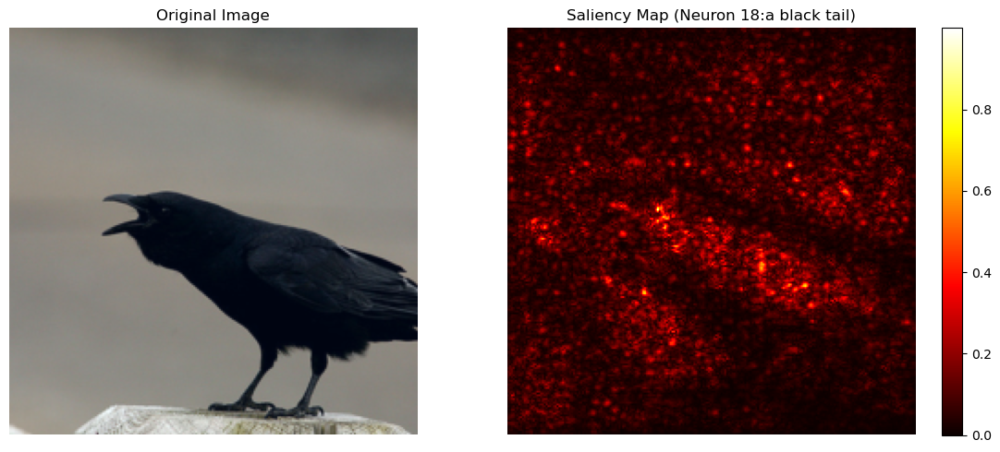

'image: 705'

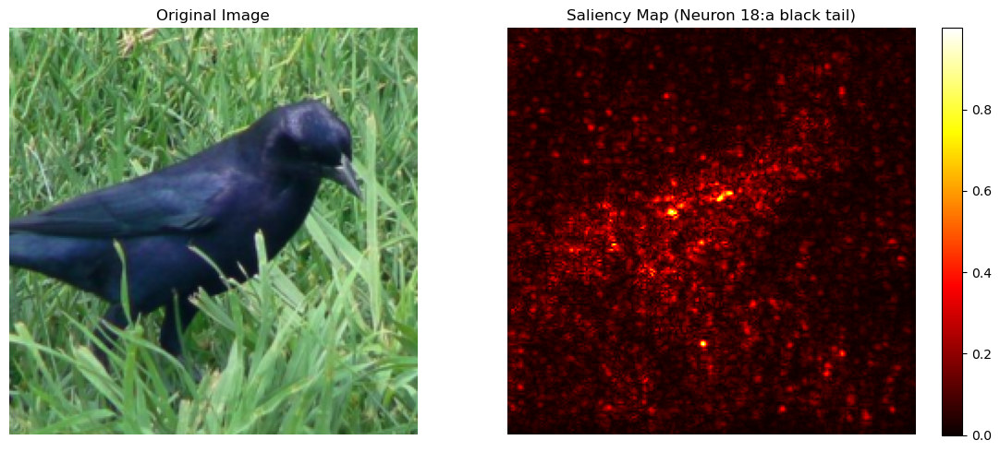

'image: 2922'

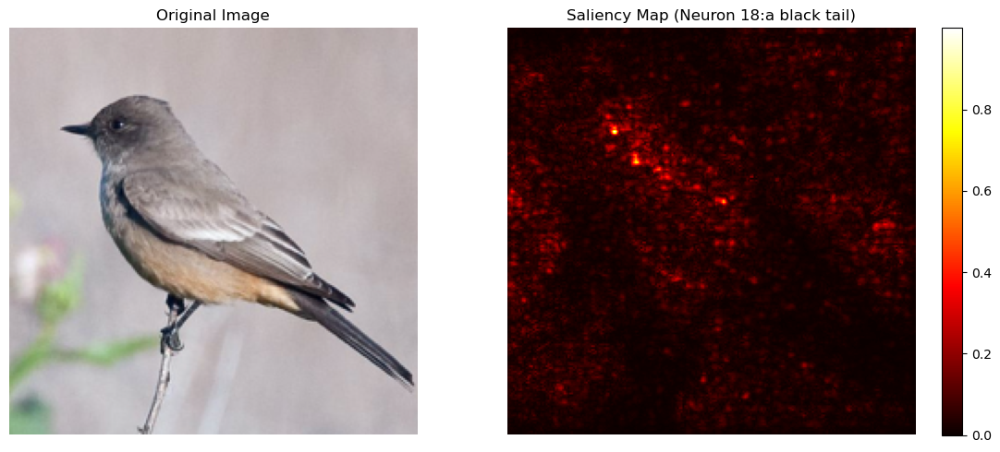

In [12]:
neuron_idx=18
image_ids=to_show
# image_ids=[0]
display(concepts[neuron_idx])
for i in image_ids:
    display(f"image: {i}")
    x=val_data_t[i][0].cuda()
    visualize_saliency_map(model, x, neuron_idx=neuron_idx)

In [13]:
len(val_data_t)

5810

## GroundingDINO

In [14]:
import groundingdino.datasets.transforms as T
from groundingdino.models import build_model
from groundingdino.util.slconfig import SLConfig
from groundingdino.util.utils import clean_state_dict
from groundingdino.util.inference import load_model, load_image, predict, annotate

from torchvision import transforms
from loguru import logger
from PIL import Image
import cv2

In [15]:
def load_annotation_model(model_config_path=HOME+"sandbox-VLG-CBM/GroundingDINO/groundingdino/config/GroundingDINO_SwinB_cfg.py", model_checkpoint_path=HOME+"sandbox-VLG-CBM/GroundingDINO/weights/groundingdino_swinb_cogcoor.pth", device="cuda"):
    args = SLConfig.fromfile(model_config_path)
    args.device = device
    model = build_model(args)
    checkpoint = torch.load(model_checkpoint_path, map_location="cpu")
    load_res = model.load_state_dict(clean_state_dict(checkpoint["model"]), strict=False)
    logger.info(load_res)
    model.eval()
    model.to(device)
    tokenlizer = model.tokenizer
    return model, tokenlizer
grounding_model,tokenizer= load_annotation_model(device=device)


final text_encoder_type: bert-base-uncased


tokenizer_config.json:   0%|          | 0.00/48.0 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/570 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/232k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/466k [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/440M [00:00<?, ?B/s]

2024-11-12 17:08:45.600 | INFO     | __main__:load_annotation_model:7 - _IncompatibleKeys(missing_keys=[], unexpected_keys=['label_enc.weight', 'bert.embeddings.position_ids'])


In [16]:
class Resize(object):
    def __init__(self, size):
        self.size = size
        self.resize = transforms.Resize((size, size))

    def __call__(self, img, target):
        return self.resize(img), target

transform = T.Compose(
        [
            # Resize(800),
            T.RandomResize([800]),
            T.ToTensor(),
            T.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225]),
        ]
    )

In [51]:
TEXT_PROMPT = f"bird . {concepts[neuron_idx]} "
BOX_TRESHOLD = 0.25
TEXT_TRESHOLD = 0.15

image_id=687

image_transformed, _=transform(val_pil_data[image_id][0],None)
image_source=np.array(val_pil_data[image_id][0].convert("RGB"))

boxes, logits, phrases = predict(
    model=grounding_model,
    image=image_transformed,
    caption=TEXT_PROMPT,
    box_threshold=BOX_TRESHOLD,
    text_threshold=TEXT_TRESHOLD
)

annotated_frame = annotate(image_source=image_source, boxes=boxes, logits=logits, phrases=phrases)

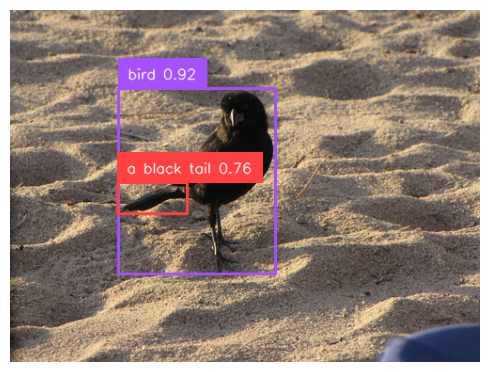

In [18]:
# Make sure we're using matplotlib inline for Jupyter/Colab
plt.figure(figsize=(5, 7))
plt.imshow(cv2.cvtColor(annotated_frame, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.axis('off')
plt.tight_layout()
plt.show()

# If you need to clear the plot after showing
plt.close()

In [19]:
from torchvision.ops import box_convert

def transform_boxes(boxes, original_size, target_size=(224, 224)):
    """
    Transform boxes from Grounding DINO preprocessing to ResNet preprocessing
    
    Args:
        boxes: tensor of shape (N, 4) in [center_x, center_y, width, height] format, normalized to [0,1]
        original_size: tuple of (height, width) after Grounding DINO's 800px resize
        target_size: tuple of (height, width) for final ResNet size (224, 224)
    """
    # Convert from cxcywh to xyxy
    boxes_xyxy = box_convert(boxes, 'cxcywh', 'xyxy')
    
    # 1. Denormalize boxes to get pixel coordinates in 800px-resized space
    boxes_xyxy = boxes_xyxy * torch.tensor([original_size[1], original_size[0], 
                                          original_size[1], original_size[0]])
    
    # 2. Scale factor from 800px to 256px resize
    scale = 256 / min(original_size)
    new_h, new_w = int(original_size[0] * scale), int(original_size[1] * scale)
    boxes_xyxy = boxes_xyxy * scale
    
    # 3. Adjust for center crop from (new_h, new_w) to (224, 224)
    x_offset = (new_w - 224) // 2
    y_offset = (new_h - 224) // 2
    
    boxes_xyxy[:, [0, 2]] -= x_offset  # adjust x coordinates
    boxes_xyxy[:, [1, 3]] -= y_offset  # adjust y coordinates
    
    # 4. Clip to image boundaries
    boxes_xyxy = torch.clamp(boxes_xyxy, min=0, max=224)
    
    # 5. Normalize to [0,1] for final 224x224 image
    boxes_xyxy = boxes_xyxy / 224
    
    # Convert back to cxcywh
    boxes_cxcywh = box_convert(boxes_xyxy, 'xyxy', 'cxcywh')
    
    return boxes_cxcywh

boxes_t = transform_boxes(boxes, (image_transformed.shape[1],image_transformed.shape[2]))
boxes_t

tensor([[0.3466, 0.4858, 0.5085, 0.6000],
        [0.2036, 0.5419, 0.2255, 0.0991]])

In [20]:
boxes

tensor([[0.3976, 0.4876, 0.3339, 0.5250],
        [0.3038, 0.5367, 0.1481, 0.0868]])

In [32]:
def compute_saliency_box_alignment(saliency_map, box, image_size):
    """
    Compute metrics for how well a saliency map aligns with a bounding box.
    
    Args:
        saliency_map (numpy.ndarray): 2D array of saliency values, normalized to [0,1]
        box (torch.Tensor): Bounding box in format [center_x, center_y, width, height]
                           with values normalized to [0,1]
        image_size (tuple): Tuple of (height, width) of the image/saliency map
    
    Returns:
        dict: Dictionary containing various alignment metrics
    """
    # Convert box from center format to pixel coordinates
    height, width = image_size
    
    # Convert center coordinates to pixels
    center_x = int(box[0] * width)
    center_y = int(box[1] * height)
    box_width = int(box[2] * width)
    box_height = int(box[3] * height)
    
    # Calculate box boundaries
    x1 = max(0, int(center_x - box_width/2))
    y1 = max(0, int(center_y - box_height/2))
    x2 = min(width, int(center_x + box_width/2))
    y2 = min(height, int(center_y + box_height/2))
    
    # Create binary mask for the box
    box_mask = np.zeros_like(saliency_map)
    box_mask[y1:y2, x1:x2] = 1
    
    # Calculate metrics
    
    # 1. IoU (Intersection over Union) with thresholded saliency map
    threshold = np.percentile(saliency_map, 70)  # Use top 30% of saliency values
    binary_saliency = (saliency_map > threshold).astype(float)
    
    intersection = np.sum(binary_saliency * box_mask)
    union = np.sum((binary_saliency + box_mask) > 0)
    iou = intersection / (union + 1e-8)
    
    # 2. Average saliency within box vs outside box
    saliency_in_box = np.mean(saliency_map[box_mask > 0])
    saliency_outside_box = np.mean(saliency_map[box_mask == 0])
    saliency_ratio = saliency_in_box / (saliency_outside_box + 1e-8)
    
    # 3. Percentage of total saliency captured by box
    total_saliency = np.sum(saliency_map)
    saliency_in_box_total = np.sum(saliency_map * box_mask)
    saliency_capture = saliency_in_box_total / (total_saliency + 1e-8)
    
    # # 4. Peak saliency location alignment
    # peak_y, peak_x = np.unravel_index(np.argmax(saliency_map), saliency_map.shape)
    # peak_in_box = box_mask[peak_y, peak_x] > 0

    # return iou
    return {
        'iou': float(iou),
        'saliency_ratio': float(saliency_ratio),
        'saliency_capture': float(saliency_capture),
        # 'peak_in_box': bool(peak_in_box)
    }

def evaluate_concept_saliency_alignment(model, image, boxes, phrases, neuron_idx):
    """
    Evaluate saliency map alignment with concept bounding boxes for multiple concepts.
    
    Args:
        model: The model to generate saliency maps
        image (torch.Tensor): Input image tensor [C, H, W]
        boxes (torch.Tensor): Bounding boxes tensor [N, 4]
        phrases (list): List of concept phrases
        neuron_indices (list): List of neuron indices corresponding to concepts
    
    Returns:
        list: List of dictionaries containing alignment metrics for each concept
    """
    image_size = (image.shape[1], image.shape[2])  # (H, W)
    concept=concepts[neuron_idx]
    no_match=True
    for box, phrase in zip(boxes, phrases):
        if phrase != concept:
            continue
        # Compute saliency map for this concept's neuron
        saliency_map = compute_saliency_map(model, image, neuron_idx)
        result=compute_saliency_box_alignment(saliency_map, box, image_size)
        no_match=False
    if no_match:
        result={'iou': 0,
        'saliency_ratio': 0,
        'saliency_capture': 0,}
        saliency_map=None
    return result, saliency_map
    
# import matplotlib.patches as patches
# def visualize_saliency_box_alignment(image, saliency_map, box, concept_name):
#     """
#     Visualize the image with bounding box and thresholded saliency map.
    
#     Args:
#         image (torch.Tensor): Input image tensor [C, H, W]
#         saliency_map (numpy.ndarray): 2D array of saliency values
#         box (torch.Tensor): Bounding box in format [center_x, center_y, width, height]
#         concept_name (str): Name of the concept for the title
#     """
#     # Convert image to numpy and move channels to last dimension
#     img = image.cpu().numpy()
#     img = np.transpose(img, (1, 2, 0))
    
#     # Normalize image for visualization
#     img = (img - img.min()) / (img.max() - img.min())
    
#     # Create figure with three subplots
#     fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(15, 5))
    
#     # 1. Original image with bounding box
#     ax1.imshow(img)
    
#     # Convert box coordinates to pixels and draw rectangle
#     height, width = img.shape[:2]
#     center_x = box[0] * width
#     center_y = box[1] * height
#     box_width = box[2] * width
#     box_height = box[3] * height
    
#     # Calculate rectangle coordinates
#     rect_x = center_x - box_width/2
#     rect_y = center_y - box_height/2
    
#     # Add rectangle patch
#     rect = patches.Rectangle(
#         (rect_x, rect_y),
#         box_width,
#         box_height,
#         linewidth=2,
#         edgecolor='r',
#         facecolor='none'
#     )
#     ax1.add_patch(rect)
#     ax1.set_title(f'Original Image with\nBounding Box for "{concept_name}"')
#     ax1.axis('off')
    
#     # 2. Saliency map
#     saliency_plot = ax2.imshow(saliency_map, cmap='hot')
#     ax2.set_title('Saliency Map')
#     ax2.axis('off')
#     plt.colorbar(saliency_plot, ax=ax2)
    
#     # 3. Image with thresholded saliency overlay
#     threshold = np.percentile(saliency_map, 70)
#     binary_saliency = (saliency_map > threshold).astype(float)
    
#     # Create red mask for thresholded areas
#     mask = np.zeros((*img.shape[:2], 4))  # RGBA
#     mask[binary_saliency > 0] = [1, 0, 0, 0.3]  # Semi-transparent red
    
#     ax3.imshow(img)
#     ax3.imshow(mask)
#     ax3.set_title('Image with Top 30%\nSaliency Overlay')
#     ax3.axis('off')
    
#     plt.tight_layout()
#     plt.show()

# Example usage:
"""
# After computing saliency map and box alignment:
saliency_map = compute_saliency_map(model, x, neuron_idx)
visualize_saliency_box_alignment(x, saliency_map, box, concept_name=concepts[neuron_idx])
"""
# Evaluate alignment
# x=val_data_t[image_id][0].cuda()
# result, saliency_map = evaluate_concept_saliency_alignment(model, x, boxes_t, phrases, neuron_idx)
# visualize_saliency_box_alignment(x, saliency_map, boxes_t[phrases.index(concepts[neuron_idx])], concepts[neuron_idx])


'\n# After computing saliency map and box alignment:\nsaliency_map = compute_saliency_map(model, x, neuron_idx)\nvisualize_saliency_box_alignment(x, saliency_map, box, concept_name=concepts[neuron_idx])\n'

In [33]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import numpy as np
import torch

def visualize_saliency_box_alignment(image, saliency_map, box, concept_name):
    """
    Visualize the image with both bounding box and saliency overlay (left)
    and saliency map (right), maximizing image size.
    
    Args:
        image (torch.Tensor): Input image tensor [C, H, W]
        saliency_map (numpy.ndarray): 2D array of saliency values
        box (torch.Tensor): Bounding box in format [center_x, center_y, width, height]
        concept_name (str): Name of the concept for the title
    """
    # Convert image to numpy and move channels to last dimension
    img = image.cpu().numpy()
    img = np.transpose(img, (1, 2, 0))
    
    # Normalize image for visualization
    img = (img - img.min()) / (img.max() - img.min())
    
    # Create figure with two subplots
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 5))
    
    # 1. Original image with both bounding box and saliency overlay
    ax1.imshow(img)
    
    # Convert box coordinates to pixels and draw rectangle
    height, width = img.shape[:2]
    center_x = box[0] * width
    center_y = box[1] * height
    box_width = box[2] * width
    box_height = box[3] * height
    
    # Calculate rectangle coordinates
    rect_x = center_x - box_width/2
    rect_y = center_y - box_height/2
    
    # Add rectangle patch with light green color
    rect = patches.Rectangle(
        (rect_x, rect_y),
        box_width,
        box_height,
        linewidth=2,
        edgecolor='lightgreen',
        facecolor='none'
    )
    ax1.add_patch(rect)
    
    # Add saliency overlay
    threshold = np.percentile(saliency_map, 70)
    binary_saliency = (saliency_map > threshold).astype(float)
    mask = np.zeros((*img.shape[:2], 4))  # RGBA
    mask[binary_saliency > 0] = [1, 0, 0, 0.3]  # Semi-transparent red
    ax1.imshow(mask)
    
    ax1.set_title(f'Concept: "{concept_name}"')
    ax1.axis('off')
    
    # 2. Saliency map
    ax2.imshow(saliency_map, cmap='hot')
    ax2.set_title('Saliency')
    ax2.axis('off')
    
    # Adjust layout to minimize empty space
    plt.subplots_adjust(left=0.01, right=0.99, top=0.9, bottom=0.01, wspace=0.01)
    plt.tight_layout()
    plt.show()

In [34]:
to_show

tensor([ 179,  687,  750, 1993,  142,  593, 3079,  806,  705, 2922],
       device='cuda:0')

In [71]:
concepts[neuron_idx].replace(',',' ')

'a large  gray body'

## put together

'yellow bill not found!'

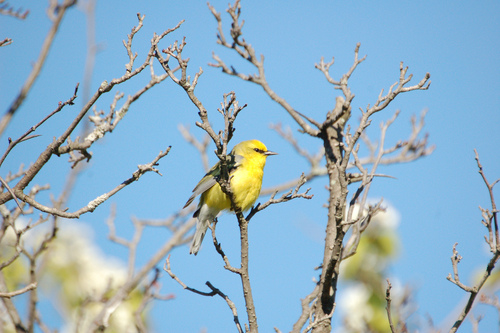

{'iou': 0, 'saliency_ratio': 0, 'saliency_capture': 0}

'yellow bill not found!'

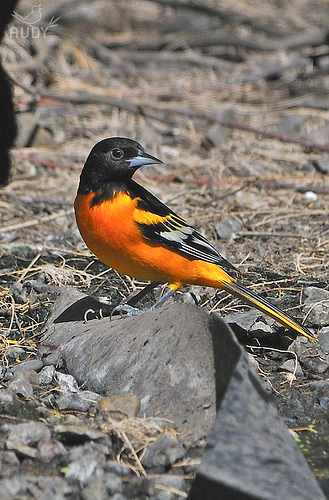

{'iou': 0, 'saliency_ratio': 0, 'saliency_capture': 0}

'yellow bill not found!'

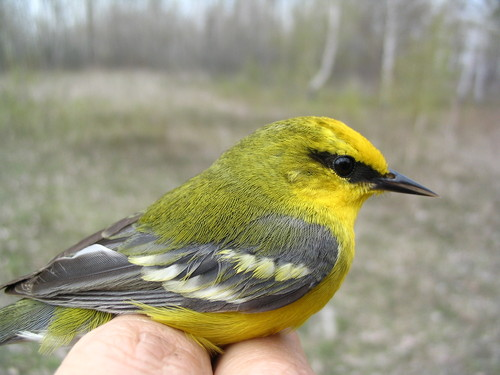

{'iou': 0, 'saliency_ratio': 0, 'saliency_capture': 0}

'yellow bill not found!'

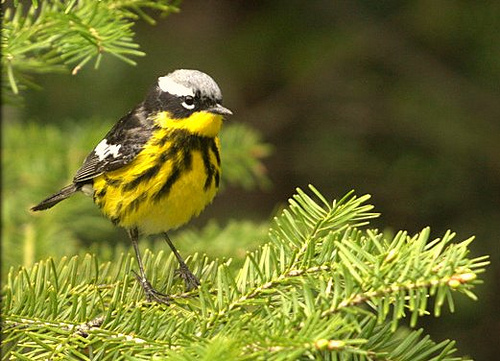

{'iou': 0, 'saliency_ratio': 0, 'saliency_capture': 0}

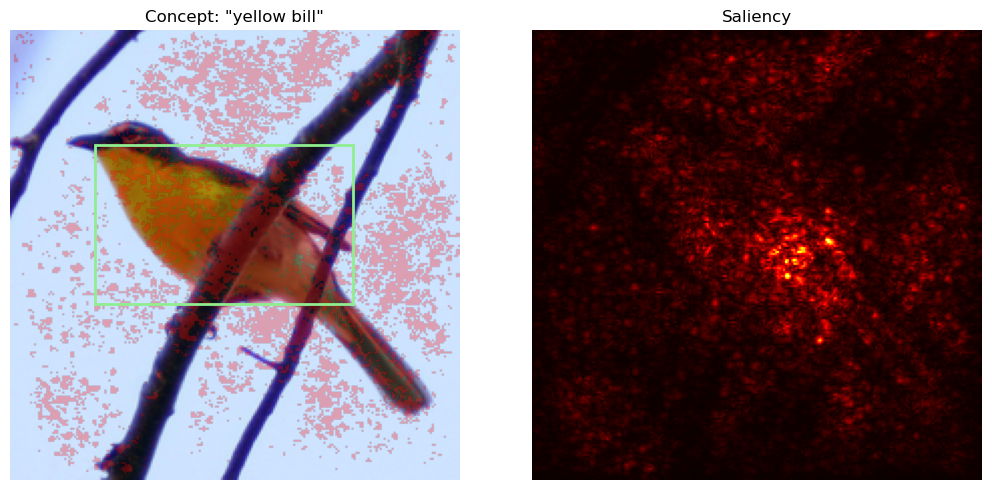

{'iou': 0.2925012840265575,
 'saliency_ratio': 2.283647377256075,
 'saliency_capture': 0.36563675862245537}

'yellow bill not found!'

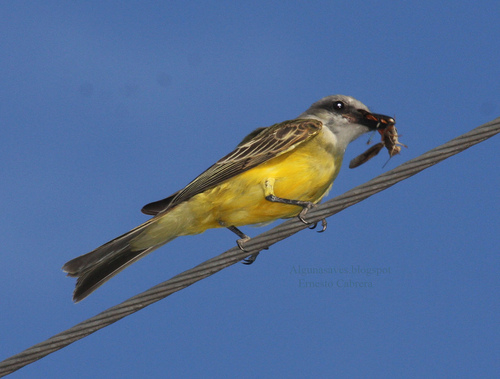

{'iou': 0, 'saliency_ratio': 0, 'saliency_capture': 0}

'yellow bill not found!'

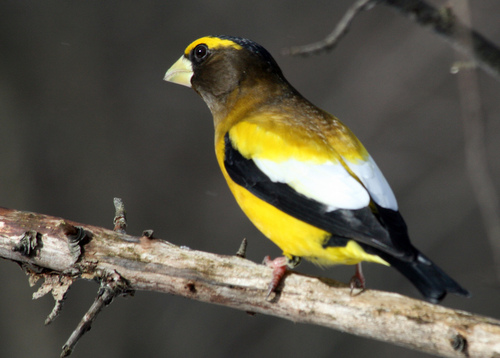

{'iou': 0, 'saliency_ratio': 0, 'saliency_capture': 0}

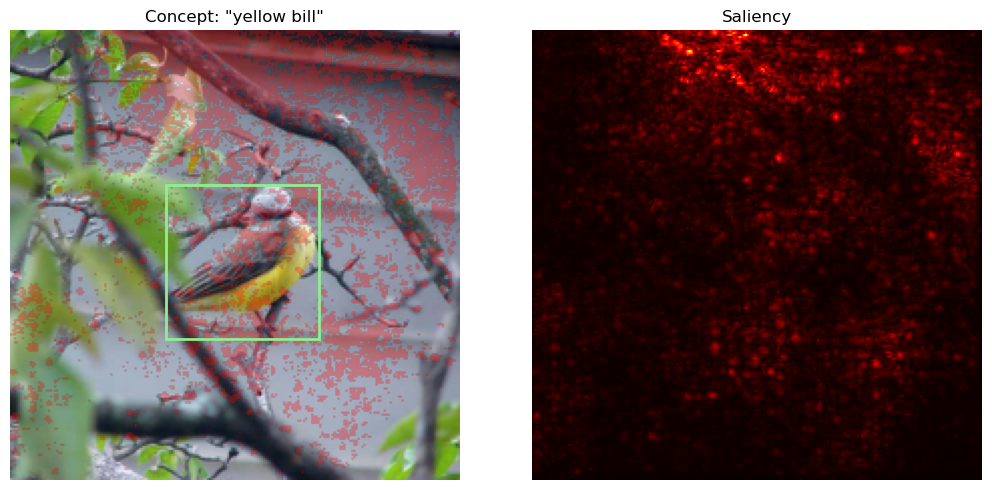

{'iou': 0.10364815996590956,
 'saliency_ratio': 1.0179133171000276,
 'saliency_capture': 0.11540028668276588}

'yellow bill not found!'

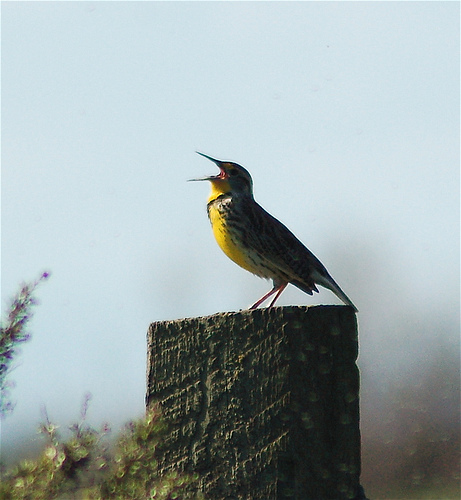

{'iou': 0, 'saliency_ratio': 0, 'saliency_capture': 0}

'yellow bill not found!'

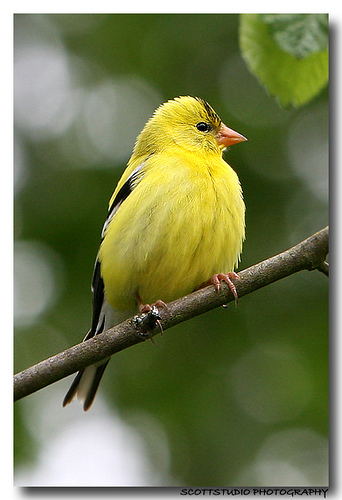

{'iou': 0, 'saliency_ratio': 0, 'saliency_capture': 0}

'yellow bill not found!'

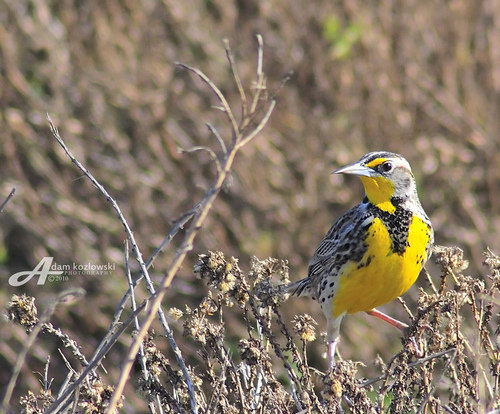

{'iou': 0, 'saliency_ratio': 0, 'saliency_capture': 0}

'yellow bill not found!'

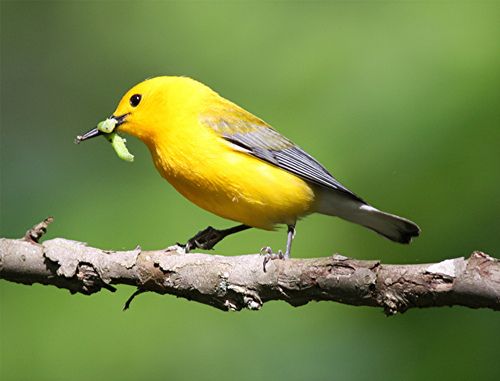

{'iou': 0, 'saliency_ratio': 0, 'saliency_capture': 0}

'yellow bill not found!'

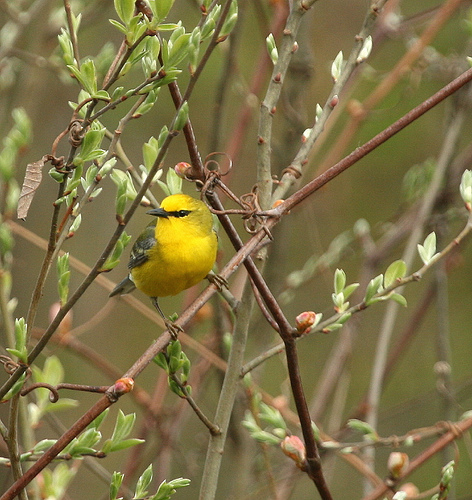

{'iou': 0, 'saliency_ratio': 0, 'saliency_capture': 0}

'yellow bill not found!'

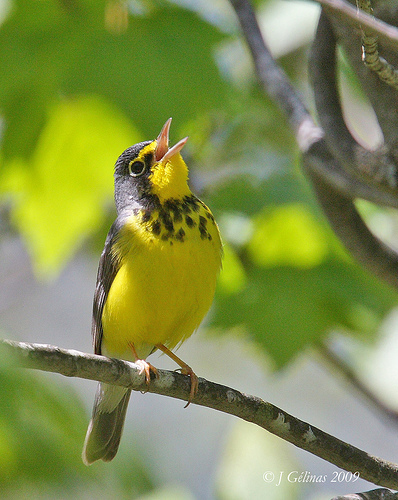

{'iou': 0, 'saliency_ratio': 0, 'saliency_capture': 0}

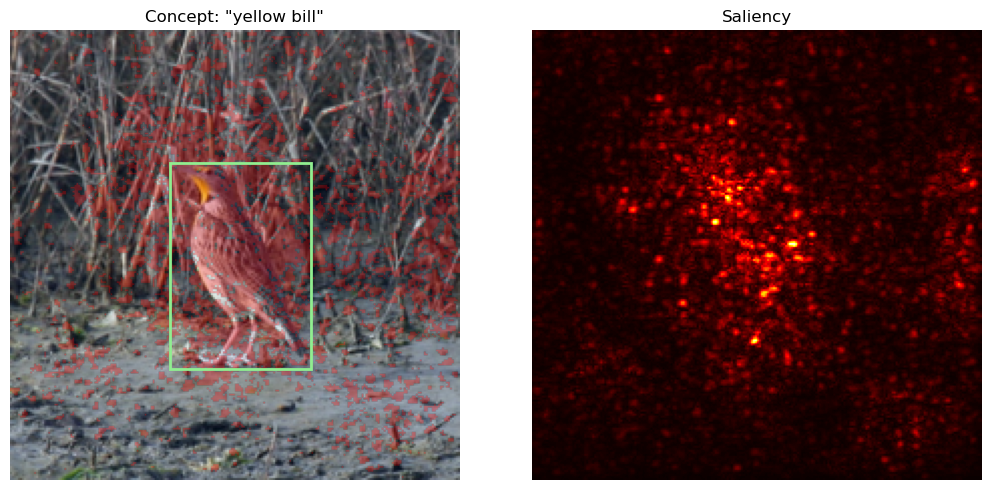

{'iou': 0.3066234913156864,
 'saliency_ratio': 2.9586736582339617,
 'saliency_capture': 0.329249197205489}

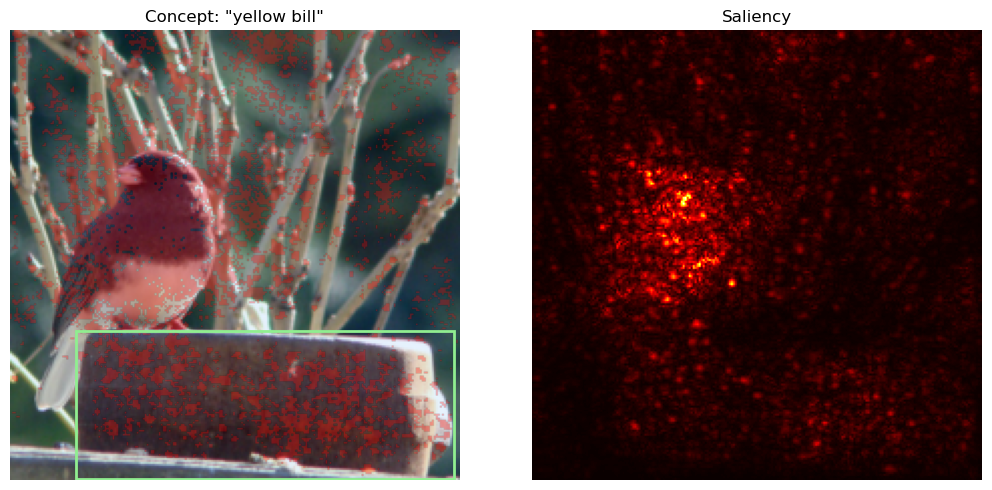

{'iou': 0.14503421932192223,
 'saliency_ratio': 0.7559681980460289,
 'saliency_capture': 0.2215587058270298}

'yellow bill not found!'

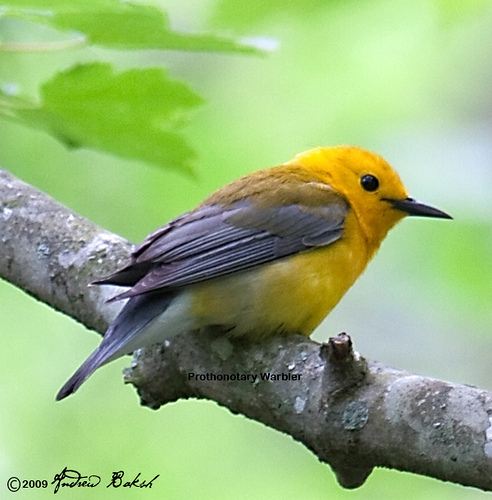

{'iou': 0, 'saliency_ratio': 0, 'saliency_capture': 0}

'yellow bill not found!'

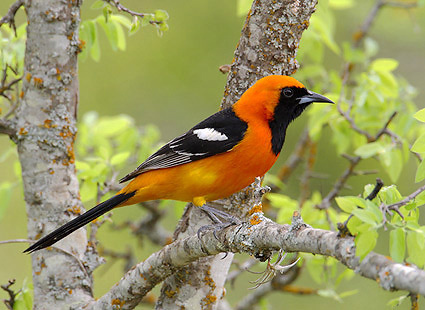

{'iou': 0, 'saliency_ratio': 0, 'saliency_capture': 0}

'yellow bill not found!'

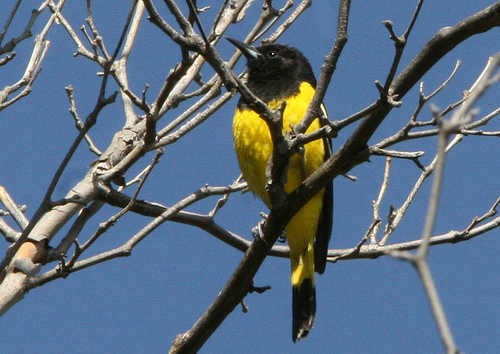

{'iou': 0, 'saliency_ratio': 0, 'saliency_capture': 0}

'yellow bill not found!'

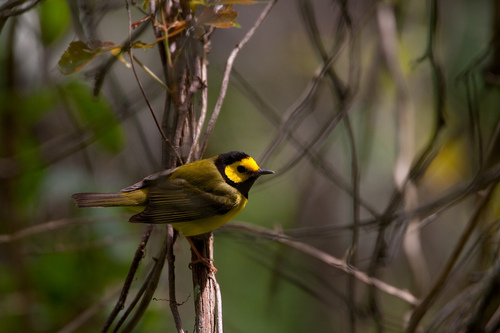

{'iou': 0, 'saliency_ratio': 0, 'saliency_capture': 0}

'yellow bill not found!'

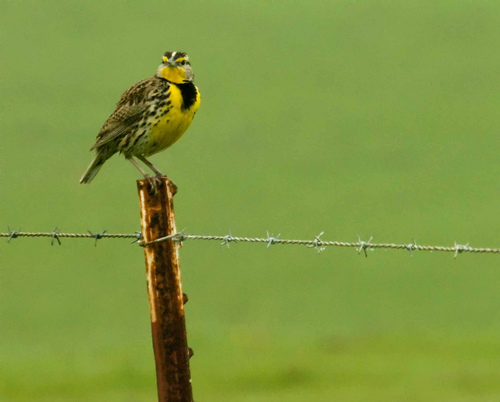

{'iou': 0, 'saliency_ratio': 0, 'saliency_capture': 0}

'yellow bill not found!'

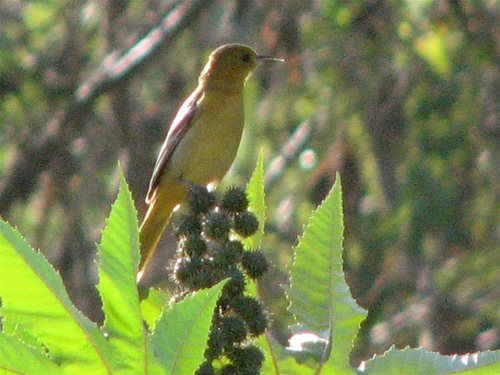

{'iou': 0, 'saliency_ratio': 0, 'saliency_capture': 0}

'yellow bill not found!'

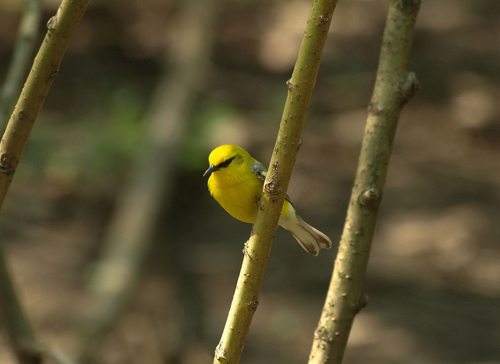

{'iou': 0, 'saliency_ratio': 0, 'saliency_capture': 0}

'yellow bill not found!'

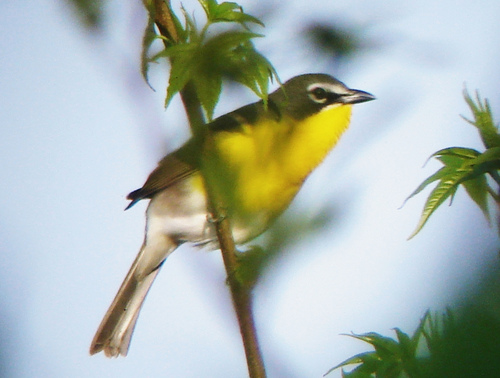

{'iou': 0, 'saliency_ratio': 0, 'saliency_capture': 0}

'yellow bill not found!'

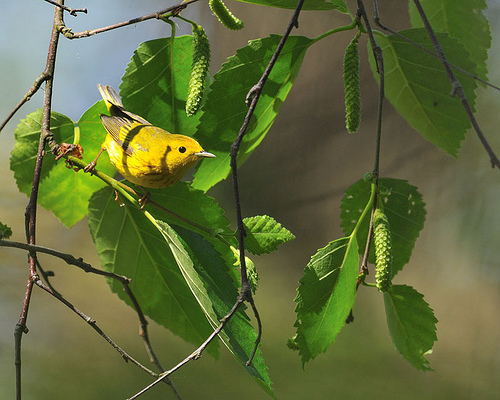

{'iou': 0, 'saliency_ratio': 0, 'saliency_capture': 0}

'yellow bill not found!'

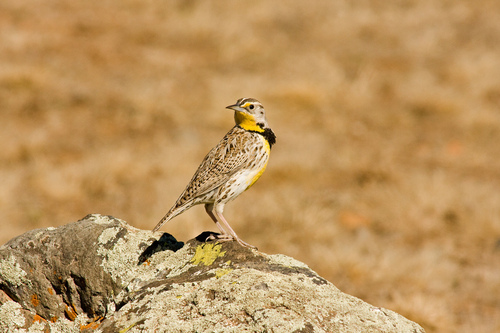

{'iou': 0, 'saliency_ratio': 0, 'saliency_capture': 0}

'yellow bill not found!'

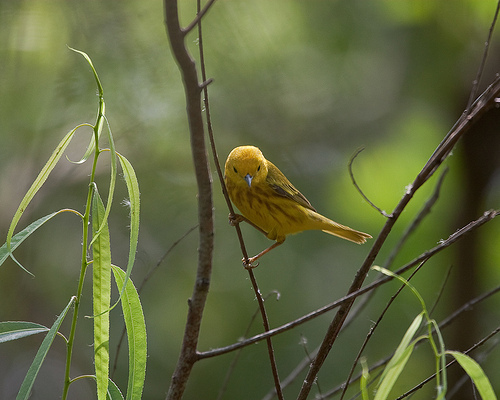

{'iou': 0, 'saliency_ratio': 0, 'saliency_capture': 0}

'yellow bill not found!'

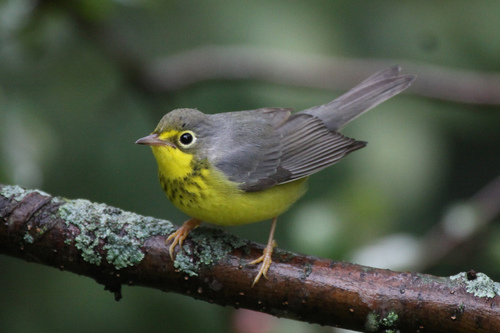

{'iou': 0, 'saliency_ratio': 0, 'saliency_capture': 0}

1.7540506376590232

In [79]:
target_neurons=[196]
all_activations = le.save_summary_activations(model, dataset, device, target_layer, batch_size, save_path, pool_mode="avg")
ratio=[]
for i in target_neurons:
    target_neuron=i
    summary_activations = all_activations[:, target_neuron]
    sorted_act_vals, sorted_act_ids = torch.sort(summary_activations, descending=True)
    to_show = sorted_act_ids[:28]
    
    # Evaluate alignment
    neuron_idx=target_neuron
    for image_id in to_show: 
        TEXT_PROMPT = f"bird . {concepts[neuron_idx]} "
        BOX_TRESHOLD = 0.35
        TEXT_TRESHOLD = 0.25
        
        # run groundingDino
        image_transformed, _=transform(val_pil_data[image_id][0],None)
        image_source=np.array(val_pil_data[image_id][0].convert("RGB"))
        boxes, logits, phrases = predict(
            model=grounding_model,
            image=image_transformed,
            caption=TEXT_PROMPT,
            box_threshold=BOX_TRESHOLD,
            text_threshold=TEXT_TRESHOLD
        )
        
        x=val_data_t[image_id][0].cuda()
        boxes_t = transform_boxes(boxes, (image_transformed.shape[1],image_transformed.shape[2]))
        
        result, saliency_map = evaluate_concept_saliency_alignment(model, x, boxes_t, phrases, neuron_idx)
        if saliency_map is not None:
            visualize_saliency_box_alignment(x, saliency_map, boxes_t[phrases.index(concepts[neuron_idx])], concepts[neuron_idx])
        else:
            display(f"{concepts[neuron_idx]} not found!")
            display(val_pil_data[image_id][0])
        ratio.append(result["saliency_ratio"])
        display(result)
# Filter out 0, None, and nan in one line
valid_ratio = [x for x in ratio if x and x is not None and not (isinstance(x, float) and np.isnan(x))]
sum(valid_ratio) / len(valid_ratio)

In [66]:
sum(valid_ratio) / len(valid_ratio)

1.5398138208594603

In [60]:
np.array(ratio).mean()

nan

In [64]:
ratio

[1.0570933901991697,
 1.6106760467298191,
 nan,
 1.6375575961328905,
 0.43246626383765335,
 1.13434301924475,
 0.9865006773658344,
 2.2854138271507725,
 1.0527209347972886,
 0.9732524759073509,
 1.756506072691728,
 1.236829904053616,
 2.897314301429693,
 2.544794139382295,
 1.7777035222902309,
 2.487603129089923,
 1.3128248332519747,
 0.9932340217503084]